In [34]:
%%capture
import os
import time
import datetime
import gsw
import hvplot.xarray
import holoviews as hv
import geoviews as gv
import numpy as np
import pandas as pd
import xarray as xr
from cartopy import crs
from scipy.interpolate import interp1d, PchipInterpolator

In [12]:
from bokeh.resources import INLINE
import bokeh.io
bokeh.io.output_notebook(INLINE)

Loading BokehJS ...

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
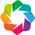

In [14]:
hv.extension('bokeh')

In [2]:
prof_list = np.loadtxt('/home/grivera/GitLab/argo/Output/cerca_costa.txt', dtype=int)
prof_list

array([3901056, 6902673, 3901808, 3901811, 3901809, 3901267, 3901813,
       3901807, 3900841, 3901257, 3901233, 3900839, 6902665, 6902674,
       3901002, 3901262, 3900840, 3901048, 3901261, 6901502, 6901461,
       3901036, 6902827, 3901266, 3901185, 6902672, 3901181, 3901272,
       6901503, 6901458, 6902809, 3901187, 3901184, 3901812, 3901231,
       3900838, 3901810, 3901200, 3901259, 3900674, 5904603, 3902142,
       3901243, 3901269, 3901234, 5902247])

In [3]:
type(prof_list[0])

numpy.int64

In [4]:
def grid_data(data_file, ix, grid = np.arange(0,2001,2.5)):
    depths = gsw.conversions.z_from_p(data_file.PRES[ix].data, data_file.LATITUDE[ix].data)
    temp = data_file.TEMP[ix].data
    salt = data_file.PSAL[ix].data
    mask = ~np.isnan(temp)
    mask[np.where(depths) == 0] = False
    if temp[mask].size ==1:
        return np.full_like(grid, np.nan, dtype=np.double), np.full_like(grid, np.nan, dtype=np.double)
    else:
        try:
            func_t = PchipInterpolator(-depths[mask],temp[mask])#, kind='linear',fill_value=np.nan,bounds_error=False)
            func_s = PchipInterpolator(-depths[mask],salt[mask])#, kind='linear',fill_value=np.nan,bounds_error=False)
        except:
            print('Error on file {}'.format(data_file))
            return np.full_like(grid, np.nan, dtype=np.double), np.full_like(grid, np.nan, dtype=np.double)
    new_grid = np.where(grid>-depths[mask][-1],np.nan,grid)
    new_grid[np.where(grid<-depths[mask][0])] = np.nan
    new_temp = func_t(new_grid)
    new_salt = func_s(new_grid)
    return new_temp, new_salt

def nc_save(prof_number, lat, lon, date, temp, salt, outdir, grid=np.arange(0,2001,2.5)):
    file_name = '{}_sprof.nc'.format(prof_number)
    temp = np.array([temp])
    salt = np.array([salt])
    to_write = xr.Dataset({'temperature': (['date','depth'],temp),
                           'psal':(['date','depth'],salt),
                           'lat':(['date'],np.array([lat])),
                           'lon':(['date'],np.array([lon]))},
                         coords={'date':np.array([date]),
                                 'depth':grid})
    return to_write

def build_profile(argo_number, traj_dir, argo_dir, outdir):
    files = crop_list(argo_number,traj_dir, argo_dir)
    files = [os.path.join(argo_dir,x) for x in files]
    container = []
    for dfile in files:
        data = xr.open_dataset(dfile)
        if argo_number in data.PLATFORM_NUMBER.data.astype(np.int):
            print('{}'.format(dfile))
            ix = np.where(data.PLATFORM_NUMBER.data.astype(np.int) == argo_number)[0]
            if ix.size > 1:
                for idx in ix:
                    temp, salt = grid_data(data, idx)
                    lat, lon = data.LATITUDE[idx].data, data.LONGITUDE[idx].data
                    date = data.JULD[idx].data
                    container.append(nc_save(argo_number, lat, lon, date, temp, salt, outdir))
            else:
                ix = ix[0]
                temp, salt = grid_data(data, ix)
                lat, lon = data.LATITUDE[ix].data, data.LONGITUDE[ix].data
                date = data.JULD[ix].data
                container.append(nc_save(argo_number, lat, lon, date, temp, salt, outdir))
        else:
            continue
    return xr.merge(container)

def get_first_date(argo_number, template):
    argo_traj = xr.open_dataset(template.format(argo_number))
    first_day = pd.to_datetime(argo_traj.JULD[0].data).date()
    return first_day

def crop_list(argo_number, traj_dir, argo_dir):
    fday = get_first_date(argo_number, os.path.join(traj_dir,'{}_Rtraj.nc'))
    fday = '{:%Y%m%d}_prof.nc'.format(fday)
    argo_files = [x for x in os.listdir(argo_dir) if x.endswith('_prof.nc')]
    ix = argo_files.index(fday)
    return argo_files[ix:]

ARGO_DIR = '/data/datos/ARGO/data/'
TRAJ_DIR = '/data/users/grivera/ARGO-traj/'
OUTPUT_DIR = '/data/users/grivera/ARGO-prof'

out = build_profile(prof_list[0],TRAJ_DIR, ARGO_DIR, OUTPUT_DIR)
out

/data/datos/ARGO/data/20141127_prof.nc
/data/datos/ARGO/data/20141128_prof.nc
/data/datos/ARGO/data/20141129_prof.nc
/data/datos/ARGO/data/20141130_prof.nc
/data/datos/ARGO/data/20141210_prof.nc
/data/datos/ARGO/data/20141220_prof.nc
/data/datos/ARGO/data/20141230_prof.nc
/data/datos/ARGO/data/20150109_prof.nc
/data/datos/ARGO/data/20150119_prof.nc
/data/datos/ARGO/data/20150129_prof.nc
/data/datos/ARGO/data/20150208_prof.nc
/data/datos/ARGO/data/20150218_prof.nc
/data/datos/ARGO/data/20150228_prof.nc
/data/datos/ARGO/data/20150310_prof.nc
/data/datos/ARGO/data/20150320_prof.nc
/data/datos/ARGO/data/20150330_prof.nc
/data/datos/ARGO/data/20150409_prof.nc
/data/datos/ARGO/data/20150419_prof.nc
/data/datos/ARGO/data/20150429_prof.nc
/data/datos/ARGO/data/20150509_prof.nc
/data/datos/ARGO/data/20150519_prof.nc
/data/datos/ARGO/data/20150529_prof.nc
/data/datos/ARGO/data/20150608_prof.nc
/data/datos/ARGO/data/20150618_prof.nc
/data/datos/ARGO/data/20150628_prof.nc
/data/datos/ARGO/data/201

<xarray.Dataset>
Dimensions:      (date: 159, depth: 801)
Coordinates:
  * date         (date) datetime64[ns] 2014-11-27T09:57:42 ... 2019-02-04T01:29:06
  * depth        (depth) float64 0.0 2.5 5.0 7.5 ... 1.995e+03 1.998e+03 2e+03
Data variables:
    temperature  (date, depth) float64 nan 24.52 24.52 24.52 ... nan nan nan nan
    psal         (date, depth) float64 nan 33.04 33.04 33.04 ... nan nan nan nan
    lat          (date) float64 -1.927 -1.924 -1.881 ... -6.454 -6.462 -6.634
    lon          (date) float64 -81.51 -81.51 -81.51 ... -83.42 -83.33 -83.28

In [25]:
# temp = out.resample(date='15D').reduce(np.nanmean)
# plot = out.temperature.hvplot.image(x='date',y='depth',cmap='viridis').options(invert_yaxis=True,width=800, height=400)

In [81]:
proj = crs.PlateCarree()

plot = hv.Dataset(out.temperature).to(hv.Image, x='date',y='depth')
cat = gv.Points((out.lon.data,out.lat.data,np.linspace(1,255,len(out.date.data))),vdims='date')

layout = gv.feature.coastline.options(scale='10m') * cat + plot

layout.opts(hv.opts.Points(color='date',cmap='Viridis', colorbar=True,size=6,line_color='k',line_width=1,tools=['hover']),
            hv.opts.Image(cmap='viridis', invert_yaxis=True,width=800, height=400),
            hv.opts.Overlay(xlim=(-90,-70),ylim=(-20,0),projection=proj,width=400,height=400))

:Layout
   .Overlay.I :Overlay
      .Coastline.I :Feature   [Longitude,Latitude]
      .Points.I    :Points   [x,y]   (date)
   .Image.I   :Image   [date,depth]   (temperature)

In [97]:
xs = np.linspace(-3, 3, 400)

def function(xs, time):
    "Some time varying function"
    return np.exp(np.sin(xs+np.pi/time))

def integral(limit, time):
    limit = -3 if limit is None else np.clip(limit,-3,3)
    curve = hv.Curve((xs, function(xs, time)))[limit:]
    area  = hv.Area ((xs, function(xs, time)))[:limit]
    summed = area.dimension_values('y').sum() * 0.015  # Numeric approximation
    return (area * curve * hv.VLine(limit) * hv.Text(limit + 0.8, 2.0, '%.2f' % summed))

integral_streams = [
    hv.streams.Stream.define('Time', time=1.0)(),
    hv.streams.PointerX().rename(x='limit')]

integral_dmap = hv.DynamicMap(integral, streams=integral_streams)

integral_dmap.opts(
    hv.opts.Area(color='#fff8dc', line_width=2),
    hv.opts.Curve(color='black'),
    hv.opts.VLine(color='red'))

:DynamicMap   []
   :Overlay
      .Area.I  :Area   [x]   (y)
      .Curve.I :Curve   [x]   (y)
      .VLine.I :VLine   [x,y]
      .Text.I  :Text   [x,y]

In [102]:
def plot_line(date):
    return hv.VLine(date)
line_streams= hv.streams.PointerX(x=out.temperature.date.data.min(),source=plot)
line = hv.DynamicMap(lambda x: hv.VLine(x), streams=[line_streams])
plot * line

:DynamicMap   []
   :Overlay
      .Image.I :Image   [date,depth]   (temperature)
      .VLine.I :VLine   [x,y]

In [17]:
points = hv.Points(np.random.rand(400, 4))

bins   = [0, .25, 0.5, .75, 1]
labels = ['circle', 'triangle', 'diamond', 'square']

layout = hv.Layout([
    points.relabel('Alpha' ).opts(alpha =hv.dim('x').norm()),
    points.relabel('Angle' ).opts(angle =hv.dim('x').norm()*360, marker='dash'),
    points.relabel('Color' ).opts(color =hv.dim('x')),
    points.relabel('Marker').opts(marker=hv.dim('x').bin(bins, labels)),
    points.relabel('Size'  ).opts(size  =hv.dim('x')*10)
])

# layout.opts(hv.opts.Points(width=250, height=250, xaxis=None, yaxis=None)).cols(5)



In [18]:
gv.help(gv.Points)

Points

Online example: http://holoviews.org/reference/elements/bokeh/Points.html

-------------
Style Options
-------------

	alpha, angle, cmap, color, fill_alpha, fill_color, hover_alpha, hover_color, hover_fill_alpha, hover_fill_color, hover_line_alpha, hover_line_color, line_alpha, line_cap, line_color, line_dash, line_join, line_width, marker, muted_alpha, muted_color, muted_fill_alpha, muted_fill_color, muted_line_alpha, muted_line_color, nonselection_alpha, nonselection_color, nonselection_fill_alpha, nonselection_fill_color, nonselection_line_alpha, nonselection_line_color, palette, selection_alpha, selection_color, selection_fill_alpha, selection_fill_color, selection_line_alpha, selection_line_color, size

(Consult bokeh's documentation for more information.)

------------
Plot Options
------------

The plot options are the parameters of the plotting class:

Parameters of 'GeoPointPlot'

Parameters changed from their default values are marked in red.
Soft bound values are ma

In [19]:
test = out.resample(date='2D').reduce(np.nanmean)
test.temperature.hvplot.image(x='date',y='depth',cmap='viridis').options(invert_yaxis=True,width=800, height=400)

/home/grivera/miniconda3/envs/Work/lib/python3.6/site-packages/xarray/core/variable.py:1354: RuntimeWarning: Mean of empty slice
  axis=axis, **kwargs)


:Image   [date,depth]   (temperature)

In [196]:
out

<xarray.DataArray 'date' (date: 159)>
array(['2014-11-27T09:57:42.000000000', '2014-11-27T18:33:12.000000256',
       '2014-11-28T18:11:47.000000000', '2014-11-29T17:44:26.000000000',
       '2014-11-30T16:59:23.000000000', '2014-12-10T15:55:28.000000000',
       '2014-12-20T14:56:24.000000000', '2014-12-30T14:13:50.000000000',
       '2015-01-09T15:25:25.000000000', '2015-01-19T15:42:51.000000000',
       '2015-01-29T16:52:43.000000000', '2015-02-08T15:53:24.999999744',
       '2015-02-18T14:44:22.000000000', '2015-02-28T13:30:46.000000000',
       '2015-03-10T12:43:00.000000000', '2015-03-20T14:06:34.000000000',
       '2015-03-30T13:05:07.000000000', '2015-04-09T11:44:59.000000000',
       '2015-04-19T12:44:53.000000000', '2015-04-29T12:36:33.000000000',
       '2015-05-09T12:26:07.000000000', '2015-05-19T11:58:43.000000000',
       '2015-05-29T12:11:26.000000000', '2015-06-08T12:05:29.000000000',
       '2015-06-18T11:55:43.000000000', '2015-06-28T10:30:04.000000000',
       '2015-

In [11]:
test = xr.open_dataset('/data/datos/ARGO/data/20190204_prof.nc')
test

<xarray.Dataset>
Dimensions:                       (N_CALIB: 1, N_HISTORY: 0, N_LEVELS: 1008, N_PARAM: 3, N_PROF: 49)
Dimensions without coordinates: N_CALIB, N_HISTORY, N_LEVELS, N_PARAM, N_PROF
Data variables:
    DATA_TYPE                     object ...
    FORMAT_VERSION                object ...
    HANDBOOK_VERSION              object ...
    REFERENCE_DATE_TIME           object ...
    DATE_CREATION                 object ...
    DATE_UPDATE                   object ...
    PLATFORM_NUMBER               (N_PROF) object ...
    PROJECT_NAME                  (N_PROF) object ...
    PI_NAME                       (N_PROF) object ...
    STATION_PARAMETERS            (N_PROF, N_PARAM) object ...
    CYCLE_NUMBER                  (N_PROF) float64 ...
    DIRECTION                     (N_PROF) object ...
    DATA_CENTRE                   (N_PROF) object ...
    DC_REFERENCE                  (N_PROF) object ...
    DATA_STATE_INDICATOR          (N_PROF) object ...
    DATA_MODE         

In [14]:
np.where(test.PLATFORM_NUMBER.astype(np.int) == 3901056)

(array([41]),)

In [16]:
test.LATITUDE[41]

<xarray.DataArray 'LATITUDE' ()>
array(-6.63388)
Attributes:
    long_name:      Latitude of the station, best estimate
    standard_name:  latitude
    units:          degree_north
    valid_min:      -90.0
    valid_max:      90.0
    axis:           Y

In [100]:
test.PLATFORM_NUMBER[62], test.PLATFORM_NUMBER[118]

(<xarray.DataArray 'PLATFORM_NUMBER' ()>
 array(b'3901056 ', dtype=object)
 Attributes:
     long_name:    Float unique identifier
     conventions:  WMO float identifier : A9IIIII,
 <xarray.DataArray 'PLATFORM_NUMBER' ()>
 array(b'5903345 ', dtype=object)
 Attributes:
     long_name:    Float unique identifier
     conventions:  WMO float identifier : A9IIIII)

In [68]:
test.JULD[118]

<xarray.DataArray 'JULD' ()>
array('2014-11-27T09:57:42.000000000', dtype='datetime64[ns]')
Attributes:
    long_name:      Julian day (UTC) of the station relative to REFERENCE_DAT...
    standard_name:  time
    conventions:    Relative julian days with decimal part (as parts of day)
    resolution:     0.0
    axis:           T

In [47]:
template = '/data/users/grivera/ARGO-traj/{}_Rtraj.nc'
data = xr.open_dataset(template.format(prof_list[0]))
data

<xarray.Dataset>
Dimensions:                              (N_CYCLE: 157, N_HISTORY: 25, N_MEASUREMENT: 11092, N_PARAM: 3)
Dimensions without coordinates: N_CYCLE, N_HISTORY, N_MEASUREMENT, N_PARAM
Data variables:
    DATA_TYPE                            object ...
    FORMAT_VERSION                       object ...
    HANDBOOK_VERSION                     object ...
    REFERENCE_DATE_TIME                  object ...
    DATE_CREATION                        object ...
    DATE_UPDATE                          object ...
    PLATFORM_NUMBER                      object ...
    PROJECT_NAME                         object ...
    PI_NAME                              object ...
    TRAJECTORY_PARAMETERS                (N_PARAM) object ...
    DATA_CENTRE                          object ...
    DATA_STATE_INDICATOR                 object ...
    PLATFORM_TYPE                        object ...
    FLOAT_SERIAL_NO                      object ...
    FIRMWARE_VERSION                     object .

In [4]:
timed = np.timedelta64(370,'D')
today = np.datetime64(datetime.date.today())
delta = today - timed
t_mask = data.JULD>delta

new_data = data.sel(N_MEASUREMENT=t_mask)
dat_mask = ~np.isnan(new_data.PRES)
new_data = new_data.sel(N_MEASUREMENT=dat_mask)
new_data

<xarray.Dataset>
Dimensions:                              (N_CYCLE: 157, N_HISTORY: 25, N_MEASUREMENT: 1769, N_PARAM: 3)
Dimensions without coordinates: N_CYCLE, N_HISTORY, N_MEASUREMENT, N_PARAM
Data variables:
    DATA_TYPE                            object ...
    FORMAT_VERSION                       object ...
    HANDBOOK_VERSION                     object ...
    REFERENCE_DATE_TIME                  object ...
    DATE_CREATION                        object ...
    DATE_UPDATE                          object ...
    PLATFORM_NUMBER                      object ...
    PROJECT_NAME                         object ...
    PI_NAME                              object ...
    TRAJECTORY_PARAMETERS                (N_PARAM) object ...
    DATA_CENTRE                          object ...
    DATA_STATE_INDICATOR                 object ...
    PLATFORM_TYPE                        object ...
    FLOAT_SERIAL_NO                      object ...
    FIRMWARE_VERSION                     object ..

In [23]:
'{:%Y%m%d}'.format(pd.to_datetime(data.JULD[0].data).date())

'20141127'

In [93]:
prof_list[0]

3901056